# Импорт библиотек

In [12]:
from PIL import Image
from tqdm import tqdm
import yaml
import os
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
from sklearn.utils.class_weight import compute_class_weight
import pandas as pd
import numpy as np
import rarfile
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.transforms import v2
from torch.utils.data import DataLoader, Dataset
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torchvision.io import read_image
from ultralytics import YOLO

выбор девайса для обучения

In [2]:
if torch.cuda.is_available(): device = 'cuda'
else: device = 'cpu'
print(f"Using {device} device")

Using cuda device


## данные для обучения

просмотр мета данных

In [4]:
with open("C:/Users/ffedo/Documents/vcs-data/train+val/data.yaml") as file:
    options = yaml.safe_load(file)
    file.close()

In [5]:
options

{'train': '../train/images',
 'val': '../valid/images',
 'test': '../test/images',
 'nc': 6,
 'names': ['five', 'four', 'one', 'six', 'three', 'two']}

загрузка тренировочных и валидационных данных в датафрейм

In [7]:
dir_path = 'C:/Users/ffedo/Documents/vcs-data/train+val/'

In [8]:
train_df = pd.DataFrame()
path = '/train/labels'

for file in tqdm(os.listdir(dir_path + path)):

    if file.endswith('.txt'):
        data = np.loadtxt(os.path.join(dir_path + path, file))

        if data.shape[-1] == 0:
            continue
        try:
            data = data.reshape((-1, 5))
        except ValueError:
            continue

        data = pd.DataFrame({'img' : [file[:-3]+'jpg'], 'labels' : [data[:, 0].astype(np.int64)], 'coords' : [data[:, 1:]]})
        train_df = pd.concat([train_df, data], ignore_index=True)

  0%|▏                                                                              | 13/8175 [00:00<01:03, 129.38it/s]C:\Users\ffedo\AppData\Local\Temp\ipykernel_3972\4290351595.py:7: UserWarning: loadtxt: input contained no data: "C:/Users/ffedo/Documents/vcs-data/train+val//train/labels\00000008_jpg.rf.89551bef161d63e28c49fc6a2be9a8ef.txt"
  data = np.loadtxt(os.path.join(dir_path + path, file))
C:\Users\ffedo\AppData\Local\Temp\ipykernel_3972\4290351595.py:7: UserWarning: loadtxt: input contained no data: "C:/Users/ffedo/Documents/vcs-data/train+val//train/labels\00000008_jpg.rf.ef86bb43b831800d2ddfb524a71cbdd8.txt"
  data = np.loadtxt(os.path.join(dir_path + path, file))
C:\Users\ffedo\AppData\Local\Temp\ipykernel_3972\4290351595.py:7: UserWarning: loadtxt: input contained no data: "C:/Users/ffedo/Documents/vcs-data/train+val//train/labels\00000008_jpg.rf.fd42c8dbcd69d25fad0e1ad78e80d390.txt"
  data = np.loadtxt(os.path.join(dir_path + path, file))
  1%|█                          

In [9]:
train_df

,img,labels,coords
0,00000000-2-_jpg.rf.0b7e9afea94e1f40a86fad4d90b...,[4],"[[0.4859375, 0.5, 0.75625, 1.0]]"
1,00000000-2-_jpg.rf.5cf24cc5cf191eec1568c9a2308...,[4],"[[0.4859375, 0.5, 0.75625, 1.0]]"
2,00000000-2-_jpg.rf.6bd48d4c3e9242e3a7bacc581e2...,[4],"[[0.4859375, 0.5, 0.7484375, 1.0]]"
3,00000000_jpg.rf.73e0c2cba2f4fc06a9923498c5a64a...,[4],"[[0.5234375, 0.5703125, 0.7091796875, 0.721484..."
4,00000000_jpg.rf.b89ba773b41817a798333b67e1ad29...,[4],"[[0.5234375, 0.5703125, 0.70859375, 0.7203125]]"
...,...,...,...
8101,WhatsApp-Image-2023-01-24-at-8-31-16-AM_jpeg.r...,[4],"[[0.57890625, 0.5125, 0.8296875, 0.912109375]]"
8102,WhatsApp-Image-2023-01-24-at-8-31-16-AM_jpeg.r...,[4],"[[0.57890625, 0.5125, 0.8296875, 0.912109375]]"
8103,WhatsApp_Image_2022-01-20_at_12107_PM_1_168811...,[5],"[[0.48125, 0.5328125, 0.91953125, 0.86171875]]"
8104,WhatsApp_Image_2022-01-20_at_12107_PM_1_168811...,[5],"[[0.48125, 0.5328125, 0.9125, 0.85390625]]"


## анализ данных

In [ ]:
train_df.info()

проверка на пропуски

In [ ]:
train_df.isna().sum().sum()

проверка на дубликаты

In [ ]:
train_df.img.duplicated().sum()

In [ ]:
train_df.coords.duplicated().sum()

## проверка на наличие изображений не относящихся к тематике датасета

In [57]:
path = 'C:/Users/ffedo/Documents/vcs-data/train+val/train/images/'
sizes = []
for i in train_df.img:
    sizes.append(os.stat(path + i).st_size)

In [60]:
train_df['size'] = sizes
train_df

,img,labels,coords,size
0,00000000-2-_jpg.rf.0b7e9afea94e1f40a86fad4d90b...,[4],"[[0.4859375, 0.5, 0.75625, 1.0]]",96018
1,00000000-2-_jpg.rf.5cf24cc5cf191eec1568c9a2308...,[4],"[[0.4859375, 0.5, 0.75625, 1.0]]",102129
2,00000000-2-_jpg.rf.6bd48d4c3e9242e3a7bacc581e2...,[4],"[[0.4859375, 0.5, 0.7484375, 1.0]]",101156
3,00000000_jpg.rf.73e0c2cba2f4fc06a9923498c5a64a...,[4],"[[0.5234375, 0.5703125, 0.7091796875, 0.721484...",75436
4,00000000_jpg.rf.b89ba773b41817a798333b67e1ad29...,[4],"[[0.5234375, 0.5703125, 0.70859375, 0.7203125]]",72867
...,...,...,...,...
8101,WhatsApp-Image-2023-01-24-at-8-31-16-AM_jpeg.r...,[4],"[[0.57890625, 0.5125, 0.8296875, 0.912109375]]",1199677
8102,WhatsApp-Image-2023-01-24-at-8-31-16-AM_jpeg.r...,[4],"[[0.57890625, 0.5125, 0.8296875, 0.912109375]]",668704
8103,WhatsApp_Image_2022-01-20_at_12107_PM_1_168811...,[5],"[[0.48125, 0.5328125, 0.91953125, 0.86171875]]",59550
8104,WhatsApp_Image_2022-01-20_at_12107_PM_1_168811...,[5],"[[0.48125, 0.5328125, 0.9125, 0.85390625]]",59341


In [92]:
anomalies = train_df.sort_values(['size'])[len(train_df)-5:]
anomalies = np.array(anomalies.img)
anomalies

array(['00000155_jpg.rf.994a9fcd6bc8627c317363d42586fe7a.jpg', '00000049_jpg.rf.4ce3a3b9f2216d0039371f15d560b40f.jpg', '00000049_jpg.rf.c1c8b9c6191a417c4eb9f48a25134659.jpg', 'WhatsApp-Image-2023-01-24-at-8-31-16-AM_jpeg.rf.d47366861eff4bb0c70fba580d133856.jpg',
       'WhatsApp-Image-2023-01-24-at-8-31-16-AM_jpeg.rf.d47366861eff4bb0c70fba580d133855.jpg'], dtype=object)

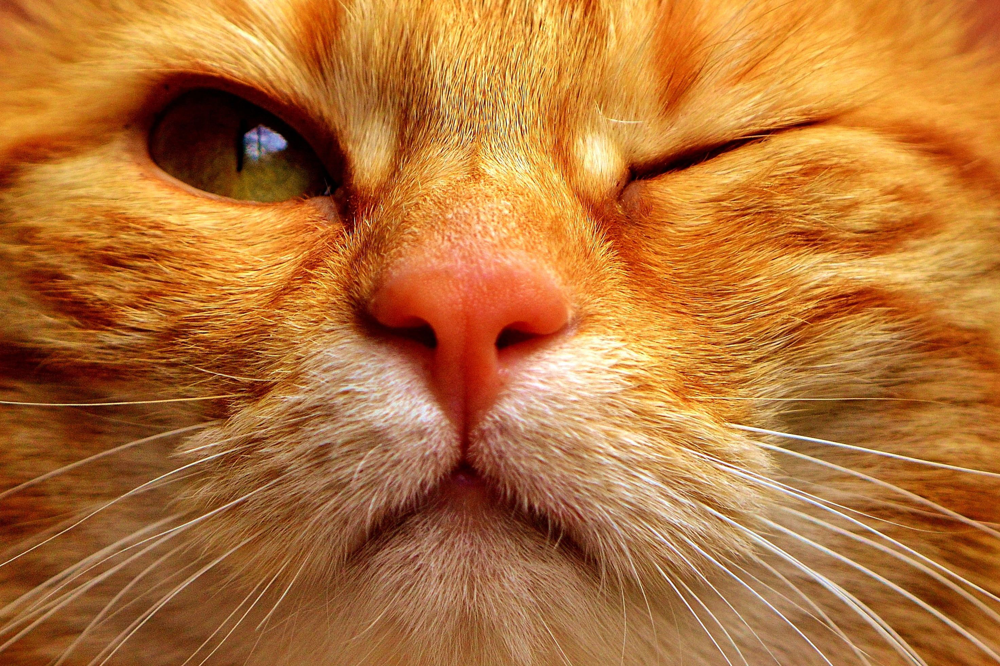

In [97]:
img = Image.open(path + anomalies[-1])
img

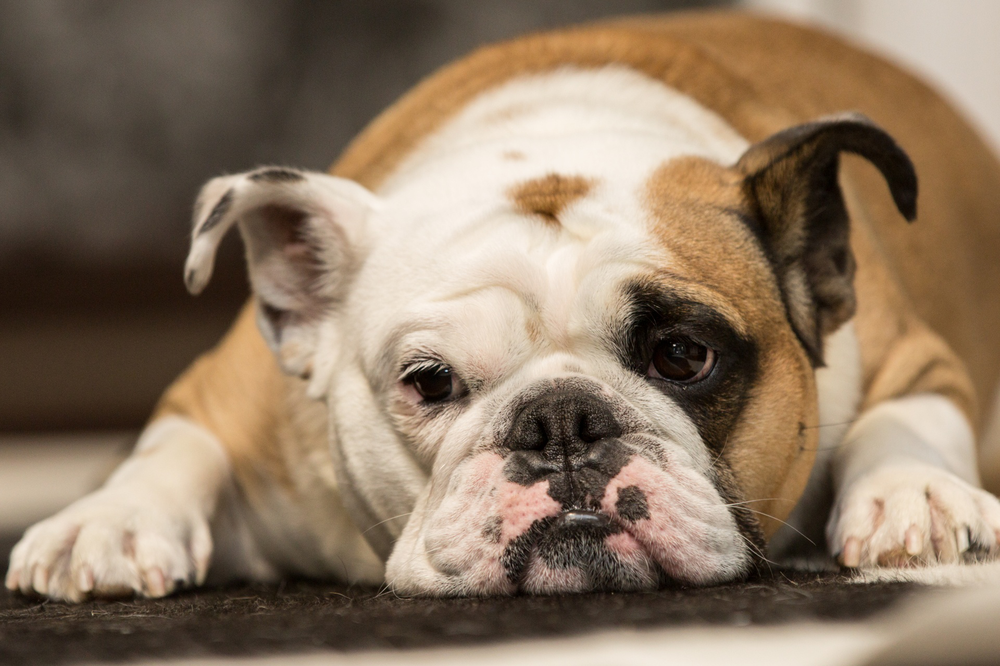

In [96]:
img = Image.open(path + anomalies[-2])
img

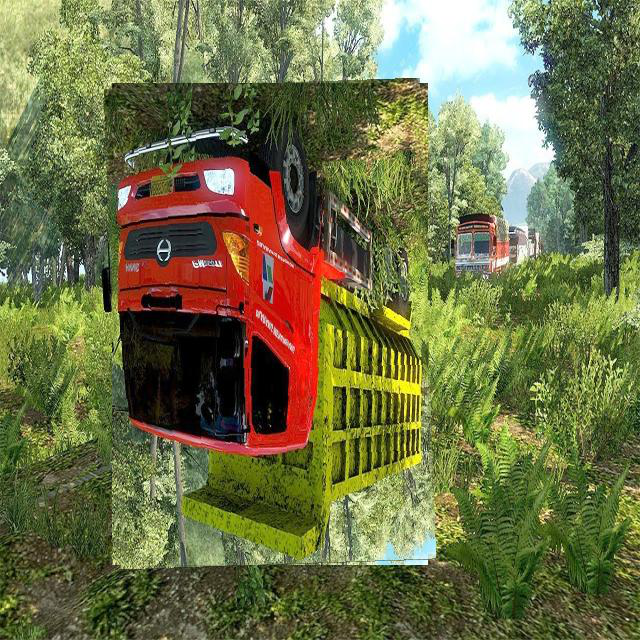

In [98]:
img = Image.open(path + anomalies[-3])
img

## удаление нерелевантных данных

## проверка на присутствие несуществующих классов и их удаление

создание списка со всеми классами

In [104]:
lst = []
for i in tqdm(train_df.labels):
    for j in i:
        lst.append(j)
len(lst)

100%|██████████████████████████████████████████████████████████████████████████| 8106/8106 [00:00<00:00, 506020.75it/s]


11778

Counter({3: 3320, 2: 3009, 4: 1386, 1: 1371, 5: 1368, 0: 1323})

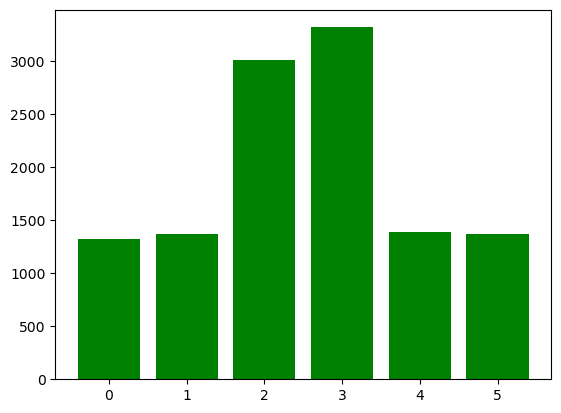

In [127]:
plt.bar(Counter(lst).keys(), Counter(lst).values(), color='g')
Counter(lst)

в данных присутсвуют несуществующие класссы, удалим их

## удаление данных с несуществующими классами

In [106]:
train_df = train_df[train_df.labels.apply(lambda x: (x > 5).sum() == 0)]

In [107]:
train_df.shape

(8105, 4)

In [108]:
lst = []
for i in tqdm(train_df.labels):
    for j in i:
        lst.append(j)
len(lst)

100%|██████████████████████████████████████████████████████████████████████████| 8105/8105 [00:00<00:00, 776279.55it/s]


11777

In [109]:
set(lst)

{0, 1, 2, 3, 4, 5}

несуществующий класс был удален

## визуальный анализ соотношения классов

Counter({3: 3320, 2: 3009, 4: 1386, 1: 1371, 5: 1368, 0: 1323})

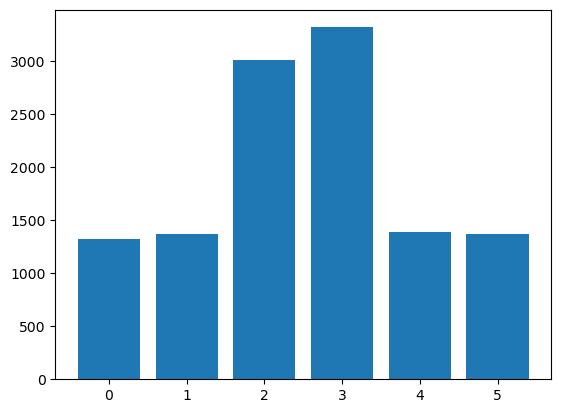

In [126]:
plt.bar(Counter(lst).keys(), Counter(lst).values())
Counter(lst)

## подсчет весов классов

In [112]:
weight = compute_class_weight(class_weight='balanced', classes=np.unique(lst), y=lst)
weight = torch.FloatTensor(weight).to(device)
weight

tensor([1.4836, 1.4317, 0.6523, 0.5912, 1.4162, 1.4348], device='cuda:0')

## аугментация

In [113]:
transform = A.Compose([
    A.Resize(256, 256),

    A.RandomBrightnessContrast(p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),

    A.Normalize(mean=[0.407, 0.457, 0.485], std=[1,1,1]),
])

создание датасета с найденными и удаленными выбросами и аугментацией

In [114]:
class Dataset(Dataset):
    def __init__(self, img_names, labels, coords, dir_path = '', transform=None):
        super().__init__()
        self.names = img_names
        self.coords = coords
        self.labels = labels
        self.dir_path = dir_path
        self.transform = transform

    def __len__(self):
        return len(self.names)

    def __getitem__(self, ind):

        #img = read_image(self.dir_path + self.names[ind])
        img = np.array(Image.open(self.dir_path + self.names[ind]))

        if self.transform:
            augmentations = self.transform(image=img)
            img = augmentations["image"]

        img = np.transpose(img, (2, 0, 1))
        img = torch.from_numpy(img)
        #img /= 255

        return img, self.labels[ind], self.coords[ind]

In [115]:
train_dir_path = "train/images/"

trainset = Dataset(
    img_names = train_df['img'].tolist(),
    labels = train_df['labels'].tolist(),
    coords = train_df['coords'].tolist(),
    dir_path = train_dir_path,
    transform = transform
)

In [116]:
trainset[0]

(tensor([[[0.4440, 0.5224, 0.5185,  ..., 0.4636, 0.4793, 0.3930],
          [0.4440, 0.5224, 0.5185,  ..., 0.4675, 0.4636, 0.4008],
          [0.4440, 0.5224, 0.5185,  ..., 0.4714, 0.4636, 0.4008],
          ...,
          [0.3106, 0.4087, 0.4950,  ..., 0.4283, 0.4401, 0.3224],
          [0.3106, 0.4087, 0.4322,  ..., 0.4401, 0.3852, 0.3381],
          [0.3695, 0.4244, 0.4008,  ..., 0.4126, 0.4244, 0.3930]],
 
         [[0.3940, 0.4724, 0.4685,  ..., 0.3940, 0.4097, 0.3234],
          [0.3940, 0.4724, 0.4685,  ..., 0.3979, 0.3940, 0.3312],
          [0.3940, 0.4724, 0.4685,  ..., 0.4018, 0.3940, 0.3312],
          ...,
          [0.2410, 0.3391, 0.4254,  ..., 0.2724, 0.2842, 0.1705],
          [0.2410, 0.3391, 0.3626,  ..., 0.2097, 0.1548, 0.1077],
          [0.2999, 0.3548, 0.3312,  ..., 0.1195, 0.1273, 0.1038]],
 
         [[0.3660, 0.4444, 0.4405,  ..., 0.3542, 0.3699, 0.2836],
          [0.3660, 0.4444, 0.4405,  ..., 0.3581, 0.3542, 0.2915],
          [0.3660, 0.4444, 0.4405,  ...,

In [117]:
trainset[0][0].shape

torch.Size([3, 256, 256])

создание даталодера

In [118]:
trainloader = DataLoader(trainset, batch_size=1)

Создание модели

In [ ]:
class rcnn(nn.Module):
    def __init__(self):
        super().__init__()
        self.cnn = nn.Sequential(
            nn.Conv2d(in_channels= 3, out_channels=16, kernel_size = 4,  stride =1 , padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size= 4),
            nn.Conv2d(in_channels= 16, out_channels= 32, kernel_size= 4,  stride =1 , padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size= 4),
            nn.Conv2d(in_channels= 32, out_channels= 64, kernel_size= 4,  stride =1 , padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size= 4),
            )
        
        self.cls = nn.Sequential(
            Linear(in_features=46208, out_features=6, bias=True)
            )

        self.genbox = nn.Sequential(
            Linear(in_features=46208, out_features=4, bias=True)
            )
        
    def forward(self, x):
        x = self.cnn(x)
        clas = self.cls(x)
        box = self.genbox(x)
        
        return [clas], [box]

model = rcnn()

In [121]:
loss_fn = nn.CrossEntropyLoss(weight = weight)
optimizer = optim.Adam(model.parameters(), lr=3e-4)